In [1]:
import pandas as pd

In [2]:
df = pd.read_csv('dataset/amazon fine food reviews/Reviews.csv')

In [3]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [4]:
# # score  - product rating
# summary  - summary of entire review
# text - complete review

# Data analysis

In [5]:
# Imports
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px

In [6]:
# Product Scores
fig = px.histogram(df, x="Score")
fig.update_traces(marker_color="turquoise",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Score')
fig.show()

In [7]:
import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud

In [8]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\mayajai\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

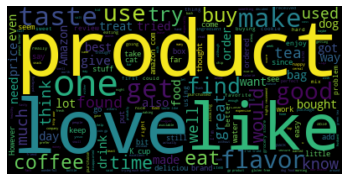

In [9]:
stop_words = set(stopwords.words('english'))
stop_words.update(["br", "href"])

textt = " ".join(review for review in df['Text'])
wordcloud = WordCloud(stopwords=stop_words).generate(textt)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.savefig('wordcloud1.png')
plt.show()

# Classify reviews into positive and negative

In [10]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [11]:
df = df[df['Score'] != 3]

In [12]:
df['Sentiment'] = df['Score'].apply(lambda x: 'positive' if x>3 else 'negative')

In [13]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Sentiment
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,positive
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,negative
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,positive
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,negative
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,positive


In [14]:
positive_df = df[df['Sentiment'] == 'positive']
negative_df = df[df['Sentiment'] == 'negative']

# wordcloud for positive sentiments

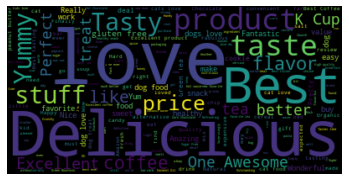

In [15]:
stop_words = set(stopwords.words('english'))
stop_words.update(['br','href','good','great'])

text1 = " ".join(summary for summary in positive_df['Summary'])
wordcloud2 = WordCloud(stopwords=stop_words).generate(text1)

plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis('off')
plt.show()

# wordclouds for negative sentiments

In [16]:
negative_df = negative_df.dropna()

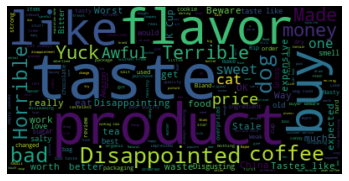

In [17]:
text2 = " ".join(summary for summary in negative_df['Summary'])
wordcloud3 = WordCloud(stopwords=stop_words).generate(text2)

plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis('off')
plt.show()

In [18]:
# Product sentiments
fig = px.histogram(df, x="Sentiment")
fig.update_traces(marker_color="turquoise",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product sentiments')
fig.show()

# Building the model

Finally, we can build the sentiment analysis model!
This model will take reviews in as input. It will then come up with a prediction on whether the review is positive or negative.
This is a classification task, so we will train a simple logistic regression model to do it.

In [19]:
# Data cleaning

In [20]:
df['Summary'].head()

0    Good Quality Dog Food
1        Not as Advertised
2    "Delight" says it all
3           Cough Medicine
4              Great taffy
Name: Summary, dtype: object

In [21]:
def remove_punctuation(text):
    return "".join(u for u in text if u not in ("?", ".", ";", ":",  "!",'"'))

df['Text'] = df['Text'].apply(remove_punctuation)
df = df.dropna(subset=['Summary'])
df['Summary'] = df['Summary'].apply(remove_punctuation)

In [22]:
df_new = df[['Summary', 'Sentiment']]
df_new

,Summary,Sentiment
0,Good Quality Dog Food,positive
1,Not as Advertised,negative
2,Delight says it all,positive
3,Cough Medicine,negative
4,Great taffy,positive
...,...,...
568449,Will not do without,positive
568450,disappointed,negative
568451,Perfect for our maltipoo,positive
568452,Favorite Training and reward treat,positive


# random split train and test data

In [32]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df['Summary'], df['Sentiment'], test_size=0.2, shuffle=True)

In [34]:
X_train.count(), X_test.count()

(420631, 105158)

In [51]:
y_train[176386]

'positive'

# count vectorizer

In [35]:
from sklearn.feature_extraction.text import CountVectorizer

In [56]:
vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')

train_matrix = vectorizer.fit_transform(X_train)
test_matrix = vectorizer.transform(X_test)

# Import Logistic Regression

In [57]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression(solver='lbfgs', max_iter=1000)

In [58]:
lr.fit(train_matrix, y_train)

LogisticRegression(max_iter=1000)

In [59]:
predictions = lr.predict(test_matrix)

In [70]:
# find accuracy, precision, recall:
from sklearn.metrics import confusion_matrix,classification_report
import numpy as np
new = np.asarray(y_test)
confusion_matrix(predictions,y_test)

array([[10807,  2190],
       [ 5450, 86711]], dtype=int64)

In [71]:
print(classification_report(predictions,y_test))

              precision    recall  f1-score   support

    negative       0.66      0.83      0.74     12997
    positive       0.98      0.94      0.96     92161

    accuracy                           0.93    105158
   macro avg       0.82      0.89      0.85    105158
weighted avg       0.94      0.93      0.93    105158

